In [1]:
from urllib.request import urlopen
import json
import requests
import pandas as pd
import numpy as np
import folium
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
from shapely.geometry import Point, Polygon
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.formula.api as sm
import altair as alt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
df2 = pd.read_csv('airbnb.csv')
df2['Weekend'] = np.where(df2['type'] == 'weekdays', 0, 1)
filterdf= df2[df2['Prijs']< 1000]
test = filterdf[['Prijs', 'dist', 'host_is_superhost', 'guest_satisfaction_overall', 'bedrooms', 'metro_dist']]

In [25]:
df2.head()

,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,type,Prijs,Weekend
0,€194.03,Private room,False,True,2.0,False,1,0,10.0,9.3,1,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,194.03,0
1,€344.25,Private room,False,True,4.0,False,0,0,8.0,8.5,1,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,344.25,0
2,€264.1,Private room,False,True,2.0,False,0,1,9.0,8.7,1,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,264.10,0
3,€433.53,Private room,False,True,4.0,False,0,1,9.0,9.0,2,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,433.53,0
4,€485.55,Private room,False,True,2.0,True,0,0,10.0,9.8,1,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,485.55,0


In [56]:
def barpot_1d():
    realnames=['Superhost','Weekend','Room type','Person capacity','Bedrooms']
    colnames=['host_is_superhost', 'type','room_type','person_capacity','bedrooms']
    fig = make_subplots(rows=1, cols=len(realnames), subplot_titles=realnames)


    for k,(col,name) in enumerate(zip(colnames, realnames)):
        series = data.value_counts(col)

        fig.add_trace(go.Bar(x=series.index, y=series.to_list(), name=name), 1,k+1)

    fig.update_layout(barmode='relative',  bargap=0.05, width=900, height=400)
    return fig

In [24]:
# https://community.plotly.com/t/how-to-visualize-3-columns-with-boolean-values/36181
# krijg het niet aan de praat

fig = make_subplots(rows=1, cols=1, subplot_titles=('Weekend'))
L= len(df2)

cnames = list(df2.columns)

for k, name in enumerate(cnames):
    n_true = df2[name].sum()
    print(n_true)
#     fig.add_trace(go.Bar(x=['True', 'False'], y=[n_true, L-n_true], name=name ), 1,k+1)
# fig.update_layout(barmode='relative',  bargap=0.05, width=700, height=400)

€194.03€344.25€264.1€433.53€485.55€552.81€215.12€2771.31€1001.8€276.52€909.47€319.64€675.6€552.81€209.03€368.85€368.85€337.92€313.55€447.59€243.25€933.85€251.92€377.29€245.59€217.7€295.03€295.03€1032.97€270.43€524.69€599.68€516.02€602.25€504.07€1609.92€310.97€202.7€796.29€504.07€319.64€614.44€467.04€716.38€350.1€319.64€467.04€983.29€298.78€196.61€430.25€319.64€405.64€334.17€491.88€319.64€780.35€355.03€1044.69€847.84€373.77€613.27€238.32€430.25€348.0€330.42€1179.67€259.18€277.93€467.04€583.74€374.94€372.37€479.23€454.85€206.45€497.74€399.55€761.84€317.06€319.41€209.03€209.03€640.45€209.03€934.08€210.2€221.22€441.26€325.5€792.77€213.95€1557.19€317.06€319.64€1044.69€310.97€295.03€344.25€3004.94€539.22€460.95€1376.51€415.49€215.12€393.46€232.23€774.26€291.05€604.6€467.04€744.5€250.74€544.14€424.16€675.6€909.47€264.1€196.61€700.44€307.22€528.2€675.6€675.6€515.78€442.67€596.16€920.49€718.96€276.52€988.21€270.43€798.63€3637.66€479.46€934.08€639.05€1474.94€1020.08€1192.09€798.63€854.4€614.44€2

amsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdamamsterdama

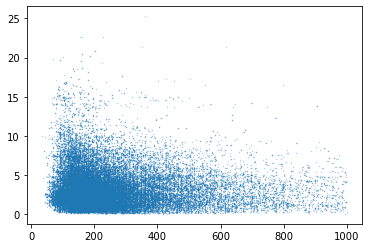

In [4]:
plt.scatter(x = filterdf['Prijs'], y = filterdf.dist, s = 0.1,alpha=0.5)
#plt.regplot(x=filterdf['Prijs'], y=filterdf.dist,scatter_kws={"color": "blue"}, line_kws={"color": "red"})

<AxesSubplot:xlabel='Prijs', ylabel='dist'>

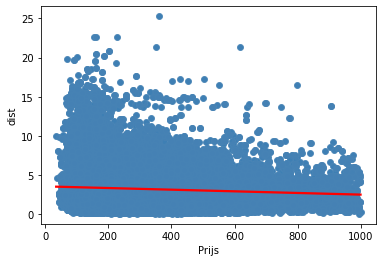

In [5]:
fig, ax1 = plt.subplots()

sns.scatterplot(x = filterdf['Prijs'], y = filterdf.dist,  ax=ax1)
## Putting a regression line. 
sns.regplot(x=filterdf['Prijs'], y=filterdf.dist, ax=ax1,scatter_kws={"color": "steelblue"}, line_kws={"color": "red"})


In [6]:
fig = px.scatter(filterdf, x="Prijs", y="dist", trendline="ols", trendline_color_override='black', labels={
                     "dist": "Afstand tot centrum (km)"},
                title="Scatterplot met regressielijn")
fig.show()

In [7]:
fig = px.scatter(filterdf, x="metro_dist", y="dist", trendline="ols", trendline_color_override='black', labels={
                     "dist": "Afstand tot centrum (km)",
"metro_dist": "Afstand tot dichtsbijzijnde metro (km)"},
                title="Scatterplot met regressielijn")
fig.show()

<AxesSubplot:>

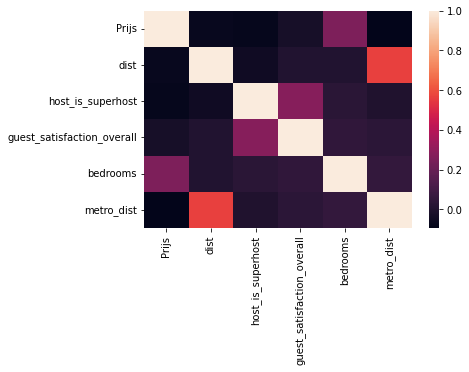

In [8]:
sns.heatmap(test.corr())

In [64]:
filterdf.head()

,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,type,Prijs,Weekend
0,€194.03,Private room,False,True,2.0,False,1,0,10.0,9.3,1,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,194.03,0
1,€344.25,Private room,False,True,4.0,False,0,0,8.0,8.5,1,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,344.25,0
2,€264.1,Private room,False,True,2.0,False,0,1,9.0,8.7,1,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,264.10,0
3,€433.53,Private room,False,True,4.0,False,0,1,9.0,9.0,2,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,433.53,0
4,€485.55,Private room,False,True,2.0,True,0,0,10.0,9.8,1,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,485.55,0


In [70]:
filterdf[filterdf.type == 'weekends']['Prijs']

1094     319.64
1095     348.00
1096     482.98
1097     485.55
1100     393.46
1101     287.77
1102     909.47
1103     393.46
1104     553.04
1105     553.04
1106     682.16
1107     233.64
1108     368.85
1109     497.50
1111     612.10
1112     858.15
1113     332.06
1114     203.88
1115     269.02
1116     295.27
1118     572.73
1119     599.91
1120     602.25
1122     331.83
1123     796.52
1124     540.62
1125     344.48
1126     479.46
1127     716.61
1128     350.34
1129     378.69
1130     299.02
1131     381.04
1132     430.25
1133     344.48
1134     406.81
1135     749.65
1136     491.88
1137     344.48
1138     817.14
1139     420.41
1140     255.67
1141     798.87
1142     368.62
1143     848.08
1144     768.17
1145     469.62
1146     613.27
1147     249.57
1148     430.25
1149     403.07
1150     442.67
1151     977.43
1152     522.34
1154     583.74
1155     374.94
1156     372.37
1157     479.23
1158     454.85
1159     614.44
1160     493.99
1161     602.02
1162    

In [81]:
import plotly.figure_factory as ff

def distplot_price(filterdf):
    fig = ff.create_distplot([filterdf[filterdf.type == 'weekends']['Prijs'].to_list(),
                              filterdf[filterdf.type == 'weekdays']['Prijs'].to_list()],
                             ['weekends', 'weekdays'])
    fig.update_layout(title='Verdeling prijs per type')
    return fig

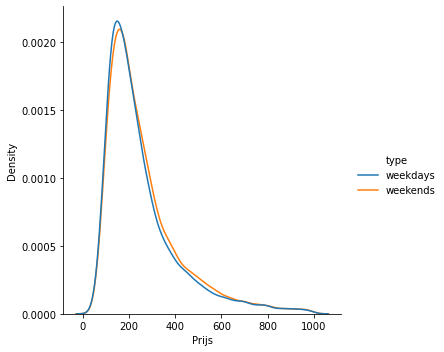

In [66]:
sns.displot(data = filterdf, x = 'Prijs', hue = 'type',kind='kde')

In [10]:
test_corr = df2[['dist', 'metro_dist']]

In [11]:
corr = sm.ols("metro_dist ~ dist", data = test_corr).fit()

In [12]:
corr.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             metro_dist   R-squared:                       0.317
Model:                            OLS   Adj. R-squared:                  0.317
Method:                 Least Squares   F-statistic:                 2.261e+04
Date:                Sun, 09 Apr 2023   Prob (F-statistic):               0.00
Time:                        21:47:57   Log-Likelihood:                -53232.
No. Observations:               48624   AIC:                         1.065e+05
Df Residuals:                   48622   BIC:                         1.065e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0260      0.005      4.728      0.000       0.015       0.037
dist           0.2040      0.001    150.376      0.000       0.201       0.207
==============================================================================
Omnibus:                    25981.903   Durbin-Watson:                   1.561
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           339769.522
Skew:                           2.286   Prob(JB):                         0.00
Kurtosis:                      15.116   Cond. No.                         7.07
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<AxesSubplot:xlabel='room_type'>

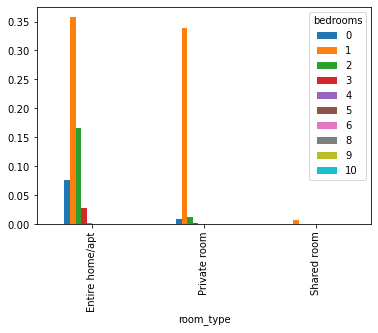

In [13]:
pd.crosstab(df2['room_type'], df2['bedrooms'], normalize = True).plot.bar()

<AxesSubplot:xlabel='Weekend'>

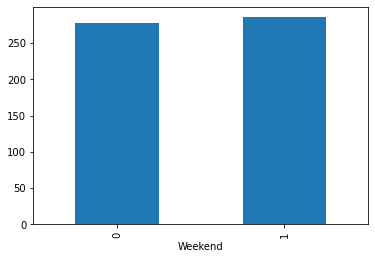

In [14]:
df2.groupby('Weekend')['Prijs'].mean().plot(kind = 'bar')

<AxesSubplot:xlabel='Prijs', ylabel='Count'>

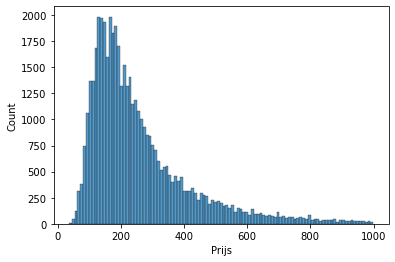

In [17]:
sns.histplot(filterdf['Prijs'])

In [82]:
filterdf.head()

,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,type,Prijs,Weekend
0,€194.03,Private room,False,True,2.0,False,1,0,10.0,9.3,1,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,194.03,0
1,€344.25,Private room,False,True,4.0,False,0,0,8.0,8.5,1,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,344.25,0
2,€264.1,Private room,False,True,2.0,False,0,1,9.0,8.7,1,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,264.10,0
3,€433.53,Private room,False,True,4.0,False,0,1,9.0,9.0,2,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,433.53,0
4,€485.55,Private room,False,True,2.0,True,0,0,10.0,9.8,1,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,485.55,0


In [84]:
px.box(data_frame=filterdf,x='city',y='Prijs')

In [118]:
import matplotlib
from matplotlib.patches import Rectangle
%matplot inline

UsageError: Line magic function `%matplot` not found.


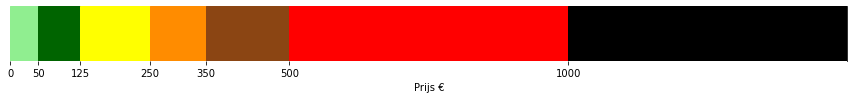

In [132]:
fig, ax = plt.subplots(figsize=(15,1))

ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['top'].set_visible(False)


ax.add_patch(Rectangle((0, 1), 50, 1,color='lightgreen'))

ax.add_patch(Rectangle((50, 1), 75, 1,color='darkgreen'))

ax.add_patch(Rectangle((125, 1), 125, 1,color='yellow'))
ax.add_patch(Rectangle((250, 1), 100, 1,color='darkorange'))
ax.add_patch(Rectangle((350, 1), 150, 1,color='saddlebrown'))
ax.add_patch(Rectangle((500, 1), 500, 1,color='red'))
ax.add_patch(Rectangle((1000, 1), 500, 1,color='black'))
ax.set_xlabel('Prijs €')

ax.set_yticks([])
ax.set_xticks([0,50,125,250,350,500,1000])

ax.set_xlim(0,1500)
ax.set_ylim(1,2)
#plt.gcf().subplots_adjust(bottom=0.15)
lsifig.savefig('legenda_appeltaart.png',bbox_inches="tight", dpi=400)

In [ ]:
list=[]
for a in range(10):
    list.append(a)

In [135]:

[a for a in range(10)]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]